## 0. Import Libraries

In [1]:
# import relevant libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

In [2]:
# ensure matplotlib plots appear inline in jupyter notebook
%matplotlib inline

In [3]:
import os
os.getcwd()

'C:\\Users\\Conor\\Documents\\Code Institute\\Capstone'

## 1. Load Data
- The original .JSON was sampled in "notebook_1_sampling" and saved as "sampled_data.csv"
- This sampled data now constitutes the raw data for this project

In [4]:
# Load data as df_raw
df_raw = pd.read_csv("sampled_data.csv")

In [5]:
# Copy df_raw to df to preserve raw data 
df = df_raw.copy()

## 2. Initial Data Overview
- An initial inspection of the data to gain general understanding, including using a y-data Profile Report to produce a summary.

In [6]:
# Inspect data
df.head()

,employee_id,role,job_level,department,tenure_months,salary,performance_score,satisfaction_score,workload_score,team_sentiment,...,goal_achievement_rate,stress_level,burnout_risk,left_company,turnover_reason,risk_factors_summary,turnover_probability_generated,persona_name,role_complexity_score,career_progression_score
0,SYN_00354572,Manager,Manager,Operations,76,73344.207475,0.597337,0.564479,0.600587,0.671515,...,0.597337,0.873155,0.815900,False,Not Applicable,Severe Burnout Risk,0.291812,QuietAchiever,0.2,0.915335
1,SYN_00733363,Genius,Mid,Sales,1,75099.833243,0.668374,0.439555,0.217266,0.760264,...,0.668374,1.000000,1.000000,True,Burnout / Work-Life Balance,Severe Burnout Risk,0.326430,CorporateNavigator,0.2,0.678354
2,SYN_00065902,Anonymous Employee,Mid,Finance,1,91841.437853,0.851203,0.617407,0.661551,0.796455,...,0.851203,0.747955,0.646864,True,Personal / Relocation,Low Risk,0.264809,CorporateNavigator,0.2,0.769768
3,SYN_00108379,Applications Developer,Mid,Bakery,59,96209.554849,0.729163,0.723819,0.579709,0.836213,...,0.729163,0.679041,0.559556,False,Not Applicable,Low Risk,0.240015,SocialCatalyst,0.2,0.890415
4,SYN_00684755,Staff,Mid,Operations,84,149529.565935,0.681677,0.885281,0.698757,0.623518,...,0.681677,0.239099,0.116914,True,Career Opportunity,Low Risk,0.164388,9-to-5Clockwatcher,0.2,0.730838


In [7]:
# Run ydata profiling to make initial discoveries about the data
from ydata_profiling import ProfileReport

profile = ProfileReport(df, title="EDA Report (Sample)", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████| 31/31 [00:15<00:00,  1.95it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Insights from Y data Profile Report
- Total number of missing cells: 971. 'role' = 862, 'department' = 109
- Workers are predominantly mid-level (71989/100000)
- 'turnover_probability_generated' has an unusual distribution
- 'role_complexity_score' is larely fixed at 0.2

#### Numerous spikes on histograms of numeric variables on otherwise normally distributed data
- 'tenure_months' @ 1
- 'salary' @ ~27000
- 'performance_score' @ 1
- 'satisfactions score' @ 0 and 1
- 'project_completion_rate' @ ~0.8
- 'overtime_hours' @ 0 - this could be representative
- 'email_sentiment' @ 1
- 'goal_achievement_rate' @ 1
- 'stress_level' @ 1
- 'burnout_risk' @ 1
- 'career_progression_score' @ 1

In [8]:
df.shape

(100000, 31)

In [9]:
df.columns

Index(['employee_id', 'role', 'job_level', 'department', 'tenure_months',
       'salary', 'performance_score', 'satisfaction_score', 'workload_score',
       'team_sentiment', 'recent_feedback', 'communication_patterns',
       'project_completion_rate', 'overtime_hours', 'training_participation',
       'collaboration_score', 'technical_skills', 'soft_skills',
       'email_sentiment', 'slack_activity', 'meeting_participation',
       'goal_achievement_rate', 'stress_level', 'burnout_risk', 'left_company',
       'turnover_reason', 'risk_factors_summary',
       'turnover_probability_generated', 'persona_name',
       'role_complexity_score', 'career_progression_score'],
      dtype='object')

In [10]:
# View all columns for initial inspection
pd.set_option("display.max_columns", None)
df.head()

,employee_id,role,job_level,department,tenure_months,salary,performance_score,satisfaction_score,workload_score,team_sentiment,recent_feedback,communication_patterns,project_completion_rate,overtime_hours,training_participation,collaboration_score,technical_skills,soft_skills,email_sentiment,slack_activity,meeting_participation,goal_achievement_rate,stress_level,burnout_risk,left_company,turnover_reason,risk_factors_summary,turnover_probability_generated,persona_name,role_complexity_score,career_progression_score
0,SYN_00354572,Manager,Manager,Operations,76,73344.207475,0.597337,0.564479,0.600587,0.671515,Fast-paced place to work Good pay & benefits w...,Exhibits communication style typical of a Quie...,0.503239,0.000000,0.426104,0.500839,"['Ansible', 'CSS3', 'AWS', 'Node.js', 'PHP (La...","['Creativity', 'Critical Thinking', 'Emotional...",0.586170,0.500839,0.500839,0.597337,0.873155,0.815900,False,Not Applicable,Severe Burnout Risk,0.291812,QuietAchiever,0.2,0.915335
1,SYN_00733363,Genius,Mid,Sales,1,75099.833243,0.668374,0.439555,0.217266,0.760264,Worse place ever to work Multiple employees co...,Exhibits communication style typical of a Corp...,0.534699,7.232818,0.491142,0.469897,"['Webpack', 'GCP', 'Azure', 'Angular']","['Leadership', 'Adaptability', 'Conflict Resol...",0.454386,0.469897,0.469897,0.668374,1.000000,1.000000,True,Burnout / Work-Life Balance,Severe Burnout Risk,0.326430,CorporateNavigator,0.2,0.678354
2,SYN_00065902,Anonymous Employee,Mid,Finance,1,91841.437853,0.851203,0.617407,0.661551,0.796455,Close to home and good shift time given Slow i...,Exhibits communication style typical of a Corp...,0.731371,0.000000,0.354473,0.596024,"['Python (Pandas, NumPy, SciPy)', 'Rust', 'Ang...","['Communication', 'Emotional Intelligence', 'M...",0.640494,0.596024,0.596024,0.851203,0.747955,0.646864,True,Personal / Relocation,Low Risk,0.264809,CorporateNavigator,0.2,0.769768
3,SYN_00108379,Applications Developer,Mid,Bakery,59,96209.554849,0.729163,0.723819,0.579709,0.836213,Excellent work environment for people who are ...,Exhibits communication style typical of a Soci...,0.647522,0.000000,0.326974,0.680088,"['Site Reliability Engineering (SRE)', 'Vue.js...","['Communication', 'Problem Solving', 'Critical...",0.733280,0.680088,0.680088,0.729163,0.679041,0.559556,False,Not Applicable,Low Risk,0.240015,SocialCatalyst,0.2,0.890415
4,SYN_00684755,Staff,Mid,Operations,84,149529.565935,0.681677,0.885281,0.698757,0.623518,Almost unlimited freedom and potential for imp...,Exhibits communication style typical of a 9-to...,0.697522,0.000000,0.043346,0.563349,"['Network Security', 'Data Warehousing (Snowfl...","['Adaptability', 'Problem Solving', 'Teamwork'...",0.862144,0.563349,0.563349,0.681677,0.239099,0.116914,True,Career Opportunity,Low Risk,0.164388,9-to-5Clockwatcher,0.2,0.730838


In [11]:
df.dtypes

employee_id                        object
role                               object
job_level                          object
department                         object
tenure_months                       int64
salary                            float64
performance_score                 float64
satisfaction_score                float64
workload_score                    float64
team_sentiment                    float64
recent_feedback                    object
communication_patterns             object
project_completion_rate           float64
overtime_hours                    float64
training_participation            float64
collaboration_score               float64
technical_skills                   object
soft_skills                        object
email_sentiment                   float64
slack_activity                    float64
meeting_participation             float64
goal_achievement_rate             float64
stress_level                      float64
burnout_risk                      

Consistent column naming conventions, all data types appear to be correct 

In [12]:
# Initial look at numerical data, scan for abnormal values.
df.describe()

,tenure_months,salary,performance_score,satisfaction_score,workload_score,team_sentiment,project_completion_rate,overtime_hours,training_participation,collaboration_score,email_sentiment,slack_activity,meeting_participation,goal_achievement_rate,stress_level,burnout_risk,turnover_probability_generated,role_complexity_score,career_progression_score
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,70.227850,84615.052278,0.691838,0.582064,0.600217,0.667906,0.595409,3.119335,0.279292,0.474170,0.582508,0.474170,0.474170,0.691838,0.790309,0.735271,0.284995,0.210964,0.840446
std,50.238135,47399.636843,0.184160,0.275934,0.199447,0.177553,0.161288,6.094216,0.222237,0.184657,0.276951,0.184657,0.184657,0.184160,0.265702,0.316818,0.087419,0.085252,0.183131
min,1.000000,27706.365337,0.102893,0.050000,0.017837,0.043792,0.082314,0.000000,0.000366,0.017709,0.042500,0.017709,0.017709,0.102893,0.000000,0.000000,0.131127,0.200000,0.185054
25%,29.000000,41301.039924,0.571540,0.367518,0.456853,0.547074,0.490493,0.000000,0.102964,0.333095,0.367678,0.333095,0.333095,0.571540,0.612267,0.479084,0.227492,0.200000,0.713145
50%,67.000000,78054.999722,0.698885,0.581650,0.614939,0.687438,0.608915,0.000000,0.222315,0.457878,0.581988,0.457878,0.457878,0.698885,0.943241,0.916082,0.299656,0.200000,0.911508
75%,105.000000,116311.687859,0.826136,0.814618,0.756383,0.806976,0.715971,4.106827,0.402143,0.601545,0.812453,0.601545,0.601545,0.826136,1.000000,1.000000,0.335232,0.200000,1.000000
max,310.000000,377381.508344,1.000000,1.000000,0.998642,0.999716,1.000000,60.106101,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.899960,1.000000,1.000000


All "score" values are on a scale of 0-1.

## 3. Feature Understanding & Cleaning
- Univariate understanding and plotting of key features
- Cleaning of dirty data
- Due to a high number of features, key features are selected for analysis

In [13]:
# check missing values
df.isna().sum()

employee_id                         0
role                              862
job_level                           0
department                        109
tenure_months                       0
salary                              0
performance_score                   0
satisfaction_score                  0
workload_score                      0
team_sentiment                      0
recent_feedback                     0
communication_patterns              0
project_completion_rate             0
overtime_hours                      0
training_participation              0
collaboration_score                 0
technical_skills                    0
soft_skills                         0
email_sentiment                     0
slack_activity                      0
meeting_participation               0
goal_achievement_rate               0
stress_level                        0
burnout_risk                        0
left_company                        0
turnover_reason                     0
risk_factors

In [14]:
# check for duplicates (removing lists which are not hashable)
df.duplicated(subset=[col for col in df.columns if df[col].apply(lambda x: not isinstance(x, list)).all()]).sum()

np.int64(0)

In [15]:
# Confirming there are no duplications
df[df.duplicated(subset=[col for col in df.columns if df[col].apply(lambda x: not isinstance(x, list)).all()])]


,employee_id,role,job_level,department,tenure_months,salary,performance_score,satisfaction_score,workload_score,team_sentiment,recent_feedback,communication_patterns,project_completion_rate,overtime_hours,training_participation,collaboration_score,technical_skills,soft_skills,email_sentiment,slack_activity,meeting_participation,goal_achievement_rate,stress_level,burnout_risk,left_company,turnover_reason,risk_factors_summary,turnover_probability_generated,persona_name,role_complexity_score,career_progression_score


- Cleaning `'role'` column. Missing values were observed.

In [16]:
# Examine how many employees fall into each role.
df['role'].value_counts()

role
 Anonymous Employee                      26674
                                         12839
Current Employee - Anonymous Employee     2579
 Manager                                  2435
 Consultant                               1992
                                         ...  
 Trading Assistant                          36
 Waitrose Supermarket Assistant             36
 Product Specialist                         36
Data Scientist                              35
 Actuarial Analyst                          33
Name: count, Length: 299, dtype: int64

- Aside from true missing values, there are other proeblems such as a large number of 'Anonymous Employee' and empty strings. Cleaning required

In [17]:
# Count true NaNs
df['role'].isna().sum()



np.int64(862)

In [18]:
# Count empty strings
(df['role'] == '').sum()

np.int64(0)

- Unexpectedly no empty strings were observed, used strip function to remove any white space
  

In [19]:
# Count rows that are only spaces without extra white space 
(df['role'].str.strip() == '').sum()

np.int64(12839)

In [20]:
# replace empty strings with 'Unknown'
df.loc[df['role'].str.strip() == '', 'role'] = 'Unknown'
df['role'].value_counts()

role
 Anonymous Employee                      26674
Unknown                                  12839
Current Employee - Anonymous Employee     2579
 Manager                                  2435
 Consultant                               1992
                                         ...  
 Trading Assistant                          36
 Waitrose Supermarket Assistant             36
 Product Specialist                         36
Data Scientist                              35
 Actuarial Analyst                          33
Name: count, Length: 299, dtype: int64

- Spotted white space in front of some values (eg Anonymous Employee, Manager)
- Strip any white space from strings in the dataset.

In [21]:
# Strip leading/trailing whitespace from all string/object columns
for col in df.select_dtypes(include='object').columns:
    df[col] = df[col].str.strip()

In [22]:
# Check whether whitespace has been removed
df['role'].value_counts()

role
Anonymous Employee                       26674
Unknown                                  12839
Current Employee - Anonymous Employee     2579
Manager                                   2571
Software Engineer                         2088
                                         ...  
Apple At Home Advisor                       38
Waitrose Supermarket Assistant              36
Trading Assistant                           36
Product Specialist                          36
Actuarial Analyst                           33
Name: count, Length: 288, dtype: int64

In [23]:
# inspect for any further abnormalities
df['role'].value_counts().head(60)

role
Anonymous Employee                       26674
Unknown                                  12839
Current Employee - Anonymous Employee     2579
Manager                                   2571
Software Engineer                         2088
Consultant                                1992
Former Employee - Anonymous Employee      1721
Associate                                 1708
Senior Consultant                         1564
Analyst                                   1551
Senior Associate                          1260
Crew Member                               1210
Cashier                                    952
Vice President                             931
Sales Assistant                            921
Customer Assistant                         856
Senior Manager                             847
Project Manager                            847
Senior Software Engineer                   829
Assistant Manager                          793
Director                                   770
Business

In [24]:
# Case-insensitive search for 'current employee' anywhere in the string
current_employee_roles = df[df['role'].str.contains("current employee", case=False, na=False)]

# View results
print(current_employee_roles['role'].value_counts())

role
Current Employee - Anonymous Employee                  2579
Current Employee - Software Engineer                    219
Current Employee - Software Development Engineer        139
Current Employee - Program Manager                       90
Current Employee - Specialist                            83
Current Employee - Software Development Engineer II      75
Current Employee - Senior Software Engineer              71
Current Employee - Warehouse Associate                   68
Current Employee - Fulfillment Associate                 66
Current Employee - Senior Program Manager                62
Name: count, dtype: int64


In [25]:
# Remove Current Employee to not create false categorisations
df['role'] = df['role'].str.replace('Current Employee - ', '')
print(df['role'].value_counts())

role
Anonymous Employee                29253
Unknown                           12839
Manager                            2571
Software Engineer                  2307
Consultant                         1992
                                  ...  
Architect                            38
Waitrose Supermarket Assistant       36
Product Specialist                   36
Trading Assistant                    36
Actuarial Analyst                    33
Name: count, Length: 280, dtype: int64


In [26]:
# Case-insensitive search for 'former employee' anywhere in the string
former_employee_roles = df[df['role'].str.contains("former employee", case=False, na=False)]

# View results
print(former_employee_roles['role'].value_counts())

role
Former Employee - Anonymous Employee               1721
Former Employee - Software Engineer                  77
Former Employee - Specialist                         71
Former Employee - Warehouse Associate                51
Former Employee - Software Development Engineer      48
Name: count, dtype: int64


In [27]:
# Remove Former Employee to not create false categorisations
df['role'] = df['role'].str.replace('Former Employee - ', '')
print(df['role'].value_counts())

role
Anonymous Employee                30974
Unknown                           12839
Manager                            2571
Software Engineer                  2384
Consultant                         1992
                                  ...  
Architect                            38
Waitrose Supermarket Assistant       36
Trading Assistant                    36
Product Specialist                   36
Actuarial Analyst                    33
Name: count, Length: 275, dtype: int64


In [28]:
print(former_employee_roles['left_company'].value_counts())
print(current_employee_roles['left_company'].value_counts())

left_company
False    1403
True      565
Name: count, dtype: int64
left_company
False    2450
True     1002
Name: count, dtype: int64


The ‘role’ column sometimes prefixes job titles with ‘Current Employee -’ or ‘Former Employee -’, but this was not fully consistent with the left_company column. For analysis, these prefixes were stripped, and left_company was used to track turnover.

In [29]:
# Combine "Anonymous Employee" and "Unknown" into a single top title 
df['role'] = df['role'].replace({'Anonymous Employee': 'Unknown/Anonymous',
                                 'Unknown': 'Unknown/Anonymous'})
print(df['role'].value_counts())

role
Unknown/Anonymous                 43813
Manager                            2571
Software Engineer                  2384
Consultant                         1992
Associate                          1708
                                  ...  
Architect                            38
Product Specialist                   36
Trading Assistant                    36
Waitrose Supermarket Assistant       36
Actuarial Analyst                    33
Name: count, Length: 274, dtype: int64


In [30]:
# Show rows which include NaN in department
df[df['department'].isna()]

,employee_id,role,job_level,department,tenure_months,salary,performance_score,satisfaction_score,workload_score,team_sentiment,recent_feedback,communication_patterns,project_completion_rate,overtime_hours,training_participation,collaboration_score,technical_skills,soft_skills,email_sentiment,slack_activity,meeting_participation,goal_achievement_rate,stress_level,burnout_risk,left_company,turnover_reason,risk_factors_summary,turnover_probability_generated,persona_name,role_complexity_score,career_progression_score
13,SYN_00137583,Unknown/Anonymous,Mid,NaN,81,89191.971825,0.632494,0.493426,0.571633,0.730400,"This will keep us number one. Caring, helping,...",Exhibits communication style typical of a Ambi...,0.505995,0.000000,0.225307,0.469900,"['Network Security', 'Data Modeling', 'Apache ...","['Critical Thinking', 'Communication', 'Mentor...",0.490494,0.469900,0.469900,0.632494,1.000000,1.000000,False,Not Applicable,Severe Burnout Risk,0.322336,AmbitiousClimber,0.2,1.000000
498,SYN_00376143,Unknown/Anonymous,Mid,NaN,4,183941.526115,0.970000,0.987323,0.969364,0.786838,It's always the first day Different store depa...,Exhibits communication style typical of a Stea...,0.976000,0.000000,0.041779,0.786838,"['Python (Pandas, NumPy, SciPy)', 'Airflow', '...","['Mentorship', 'Adaptability', 'Creativity', '...",1.000000,0.786838,0.786838,0.970000,0.000000,0.000000,False,Not Applicable,Low Risk,0.131127,SteadyEddy,0.2,0.701667
1411,SYN_00370622,Unknown/Anonymous,Mid,NaN,81,61505.478607,0.554994,0.326230,0.883145,0.823073,"Great experience, but for career, think twice ...",Exhibits communication style typical of a Burn...,0.443995,0.000000,0.037919,0.437968,"['XGBoost', 'React', 'Network Security', 'GCP'...","['Time Management', 'Leadership', 'Conflict Re...",0.331591,0.437968,0.437968,0.554994,1.000000,1.000000,True,Compensation / Role Dissatisfaction,Severe Burnout Risk,0.339463,BurntOutStar,0.2,0.754997
2324,SYN_00188107,Unknown/Anonymous,Mid,NaN,196,55474.441043,0.672643,0.772177,0.427364,0.543090,Great place to learn. Great culture and work e...,Exhibits communication style typical of a 9-to...,0.624917,6.739293,0.002646,0.469586,"['Data Modeling', 'SQL', 'Apache Spark', 'CI/C...","['Communication', 'Mentorship', 'Conflict Reso...",0.806652,0.469586,0.469586,0.672643,0.565985,0.425801,False,Not Applicable,Low Risk,0.211581,9-to-5Clockwatcher,0.2,1.000000
3158,SYN_00550672,Director,Lead,NaN,37,148176.169432,0.707207,0.553512,0.695551,0.227243,"Great company to work for, rapid growth potent...",Exhibits communication style typical of a Seas...,0.641478,0.000000,0.060898,0.176245,"['dbt', 'TypeScript', 'Java (Spring Boot)', 'X...","['Communication', 'Emotional Intelligence', 'T...",0.578677,0.176245,0.176245,0.707207,0.621440,0.489890,False,Not Applicable,Low Risk,0.255231,SeasonedExpert,0.2,0.667770
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96598,SYN_00002835,Unknown/Anonymous,Mid,NaN,179,30128.600156,0.718607,1.000000,0.531030,0.768138,Job perks such as free canteen meals Tons of e...,Exhibits communication style typical of a Soci...,0.691091,0.000000,0.375265,0.768138,"['Network Security', 'Deep Learning (TensorFlo...","['Mentorship', 'Emotional Intelligence', 'Conf...",1.000000,0.768138,0.768138,0.718607,0.418970,0.271191,False,Not Applicable,Low Risk,0.162218,SocialCatalyst,0.2,1.000000
96664,SYN_00380330,Unknown/Anonymous,Mid,NaN,29,131534.864391,0.625567,0.794894,0.776223,0.597030,Compensation is competitive and move up fast. ...,Exhibits communication style typical of a Chan...,0.552549,0.000000,0.104731,0.506867,"['Deep Learning (TensorFlow, PyTorch)', 'SQL',...","['Emotional Intelligence', 'Problem Solving', ...",0.784257,0.506867,0.506867,0.625567,0.739520,0.635953,True,Career Opportunity,Low Risk,0.241593,ChangeResistor,0.2,0.513617
97129,SYN_00451974,Unknown/Anonymous,Mid,NaN,58,47500.859698,0.577648,0.429960,0.443388,0.750303,"FUN, YOUNG

In [31]:
# Filling missing values in department
df['department'] = df['department'].fillna('Unknown')

In [32]:
# Check to ensure it worked
df[df['department'].isna()]

,employee_id,role,job_level,department,tenure_months,salary,performance_score,satisfaction_score,workload_score,team_sentiment,recent_feedback,communication_patterns,project_completion_rate,overtime_hours,training_participation,collaboration_score,technical_skills,soft_skills,email_sentiment,slack_activity,meeting_participation,goal_achievement_rate,stress_level,burnout_risk,left_company,turnover_reason,risk_factors_summary,turnover_probability_generated,persona_name,role_complexity_score,career_progression_score


As missing department values account for only 0.1% of the data, they are retained and labeled as “Unknown” to preserve observations without introducing assumptions.

- Salary figures are floats containing 6 decimal places. For cleanliness, convert to integer.

In [33]:
# convert salary to integer
df['salary'] = df['salary'].round(0).astype('Int64')

In [34]:
df.head()

,employee_id,role,job_level,department,tenure_months,salary,performance_score,satisfaction_score,workload_score,team_sentiment,recent_feedback,communication_patterns,project_completion_rate,overtime_hours,training_participation,collaboration_score,technical_skills,soft_skills,email_sentiment,slack_activity,meeting_participation,goal_achievement_rate,stress_level,burnout_risk,left_company,turnover_reason,risk_factors_summary,turnover_probability_generated,persona_name,role_complexity_score,career_progression_score
0,SYN_00354572,Manager,Manager,Operations,76,73344,0.597337,0.564479,0.600587,0.671515,Fast-paced place to work Good pay & benefits w...,Exhibits communication style typical of a Quie...,0.503239,0.000000,0.426104,0.500839,"['Ansible', 'CSS3', 'AWS', 'Node.js', 'PHP (La...","['Creativity', 'Critical Thinking', 'Emotional...",0.586170,0.500839,0.500839,0.597337,0.873155,0.815900,False,Not Applicable,Severe Burnout Risk,0.291812,QuietAchiever,0.2,0.915335
1,SYN_00733363,Genius,Mid,Sales,1,75100,0.668374,0.439555,0.217266,0.760264,Worse place ever to work Multiple employees co...,Exhibits communication style typical of a Corp...,0.534699,7.232818,0.491142,0.469897,"['Webpack', 'GCP', 'Azure', 'Angular']","['Leadership', 'Adaptability', 'Conflict Resol...",0.454386,0.469897,0.469897,0.668374,1.000000,1.000000,True,Burnout / Work-Life Balance,Severe Burnout Risk,0.326430,CorporateNavigator,0.2,0.678354
2,SYN_00065902,Unknown/Anonymous,Mid,Finance,1,91841,0.851203,0.617407,0.661551,0.796455,Close to home and good shift time given Slow i...,Exhibits communication style typical of a Corp...,0.731371,0.000000,0.354473,0.596024,"['Python (Pandas, NumPy, SciPy)', 'Rust', 'Ang...","['Communication', 'Emotional Intelligence', 'M...",0.640494,0.596024,0.596024,0.851203,0.747955,0.646864,True,Personal / Relocation,Low Risk,0.264809,CorporateNavigator,0.2,0.769768
3,SYN_00108379,Applications Developer,Mid,Bakery,59,96210,0.729163,0.723819,0.579709,0.836213,Excellent work environment for people who are ...,Exhibits communication style typical of a Soci...,0.647522,0.000000,0.326974,0.680088,"['Site Reliability Engineering (SRE)', 'Vue.js...","['Communication', 'Problem Solving', 'Critical...",0.733280,0.680088,0.680088,0.729163,0.679041,0.559556,False,Not Applicable,Low Risk,0.240015,SocialCatalyst,0.2,0.890415
4,SYN_00684755,Staff,Mid,Operations,84,149530,0.681677,0.885281,0.698757,0.623518,Almost unlimited freedom and potential for imp...,Exhibits communication style typical of a 9-to...,0.697522,0.000000,0.043346,0.563349,"['Network Security', 'Data Warehousing (Snowfl...","['Adaptability', 'Problem Solving', 'Teamwork'...",0.862144,0.563349,0.563349,0.681677,0.239099,0.116914,True,Career Opportunity,Low Risk,0.164388,9-to-5Clockwatcher,0.2,0.730838


In [35]:
df['role'].value_counts()

role
Unknown/Anonymous                 43813
Manager                            2571
Software Engineer                  2384
Consultant                         1992
Associate                          1708
                                  ...  
Architect                            38
Product Specialist                   36
Trading Assistant                    36
Waitrose Supermarket Assistant       36
Actuarial Analyst                    33
Name: count, Length: 274, dtype: int64

In [36]:
# Remove 'Anonymous/Unknown' for top roles.
top_known_roles = df[df['role'] != 'Unknown/Anonymous']

In [37]:
top_known_roles['role'].value_counts().head(20)

role
Manager                            2571
Software Engineer                  2384
Consultant                         1992
Associate                          1708
Senior Consultant                  1564
Analyst                            1551
Senior Associate                   1260
Crew Member                        1210
Cashier                             952
Vice President                      931
Sales Assistant                     921
Senior Software Engineer            900
Customer Assistant                  856
Senior Manager                      847
Project Manager                     847
Assistant Manager                   793
Director                            770
Business Analyst                    750
Customer Service Representative     663
Sales Associate                     557
Name: count, dtype: int64

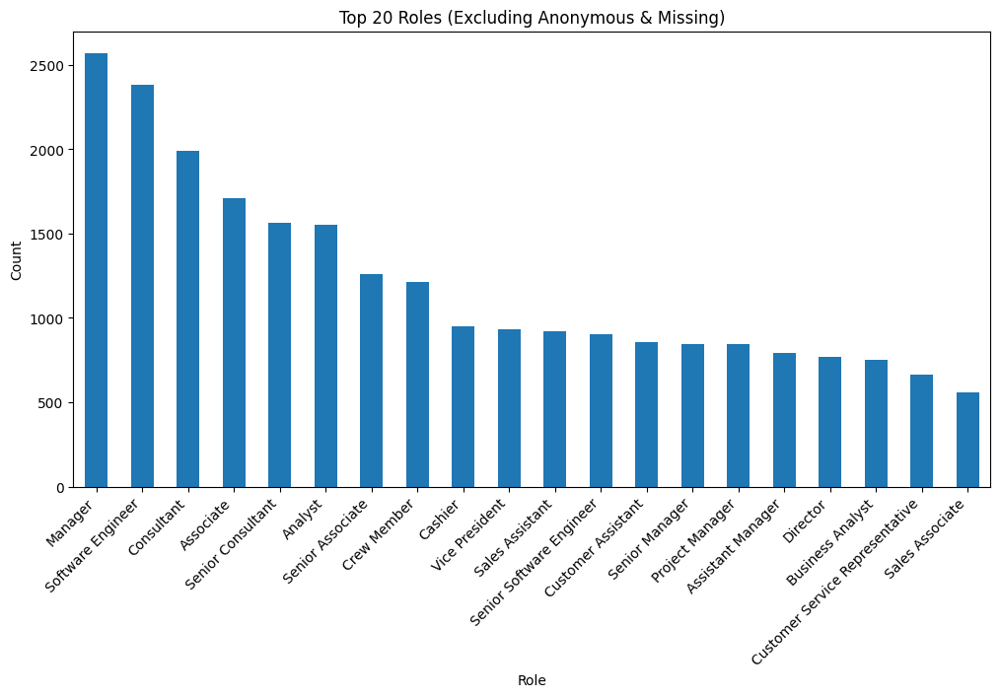

In [38]:
# plot top 20 roles excluding anoymous and missing
plt.figure(figsize=(12,6))
top_known_roles['role'].value_counts().head(20).plot(kind='bar')
plt.title('Top 20 Roles (Excluding Anonymous & Missing)')
plt.ylabel('Count')
plt.xlabel('Role')
plt.xticks(rotation=45, ha='right')
plt.show()

In [39]:
# Check for duplicates in employee_id
df['employee_id'].value_counts()

employee_id
SYN_00354572    1
SYN_00733363    1
SYN_00065902    1
SYN_00108379    1
SYN_00684755    1
               ..
SYN_00386528    1
SYN_00548384    1
SYN_00232114    1
SYN_00390377    1
SYN_00290929    1
Name: count, Length: 100000, dtype: int64

In [40]:
# Check distribution of job levels
df['job_level'].value_counts()

job_level
Mid        71989
Entry      11938
Manager     9141
Senior      4688
Lead        2244
Name: count, dtype: int64

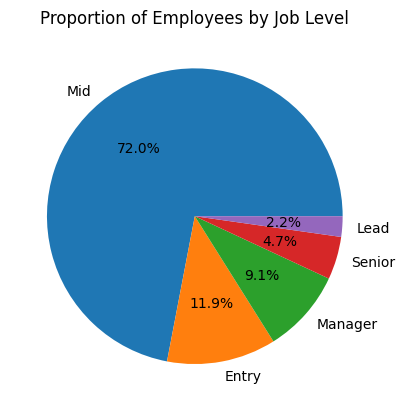

In [41]:
# Plot job level distribution & percentages
ax = df['job_level'].value_counts().plot(
    kind='pie',
    autopct='%1.1f%%'
)

ax.set_ylabel('')  # removes default y-axis label
plt.title('Proportion of Employees by Job Level')
plt.show()

In [42]:
# Check distribution of employees by department & create top 20 
departments = df['department'].value_counts()
top_departments = departments.head(20)
top_departments

department
Sales & Marketing         18391
Research & Development    12032
Operations                11859
Technology                 7604
Procurement                7476
Analytics                  5779
Sales                      5763
Customer Service           4309
Meats                      3846
Dairy                      3727
Bakery                     3601
Produce                    2777
Finance                    2754
HR                         2696
Processed Foods            1913
Production                 1545
Legal                      1157
R&D                        1042
Human Resources             737
IT/IS                       269
Name: count, dtype: int64

C:\Users\Conor\AppData\Local\Temp\ipykernel_16692\746062838.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_departments.values, y=top_departments.index, palette="viridis")


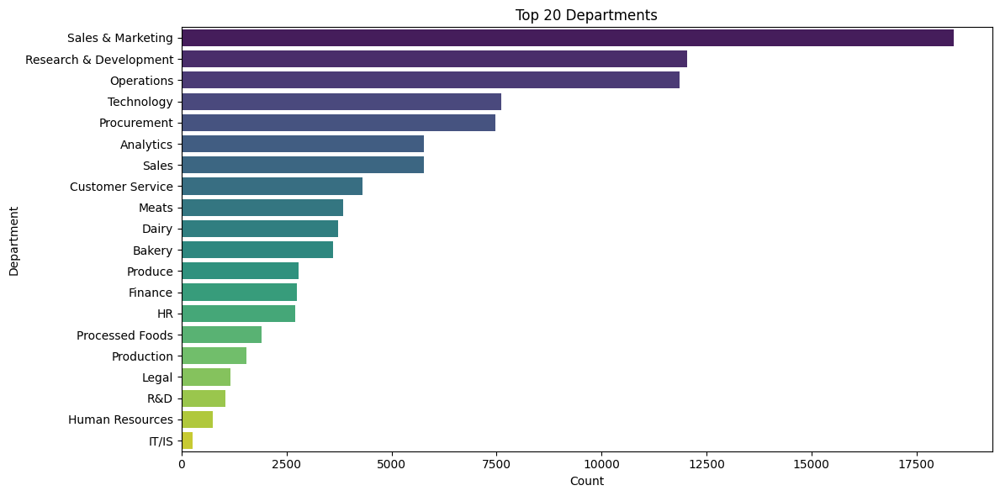

In [43]:
# Plot top 20 departments with Seaborn
plt.figure(figsize=(12,6))
sns.barplot(x=top_departments.values, y=top_departments.index, palette="viridis")
plt.xlabel("Count")
plt.ylabel("Department")
plt.title("Top 20 Departments")
plt.tight_layout()
plt.show()

In [44]:
df['tenure_months'].value_counts()

tenure_months
1      11988
66       757
73       753
72       736
80       736
       ...  
286        1
278        1
308        1
285        1
273        1
Name: count, Length: 276, dtype: int64

- High proportion of employees with just 1 month of tenure

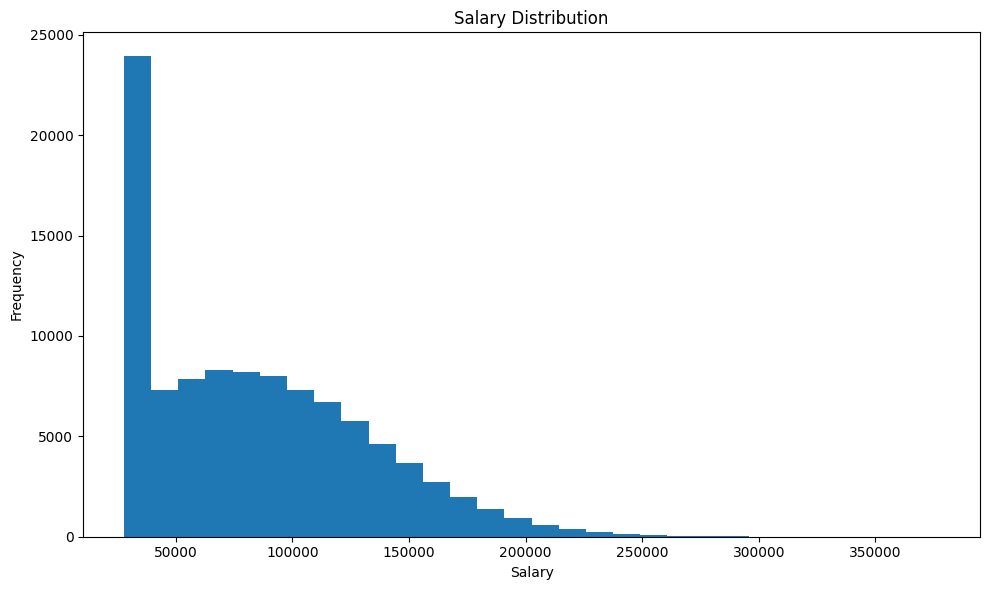

In [45]:
plt.figure(figsize=(10,6))
plt.hist(df['salary'], bins=30)
plt.xlabel('Salary')
plt.ylabel('Frequency')
plt.title('Salary Distribution')
plt.tight_layout()
plt.show()

In [46]:
# check for a high proportion of same value salaries
df['salary'].value_counts()

salary
29667     25
29741     22
29767     22
29555     21
29884     21
          ..
133622     1
114542     1
145404     1
44636      1
118357     1
Name: count, Length: 64748, dtype: Int64

- There is a spike at the low end of the histogram, however there is no single figure that is repeated excessively.

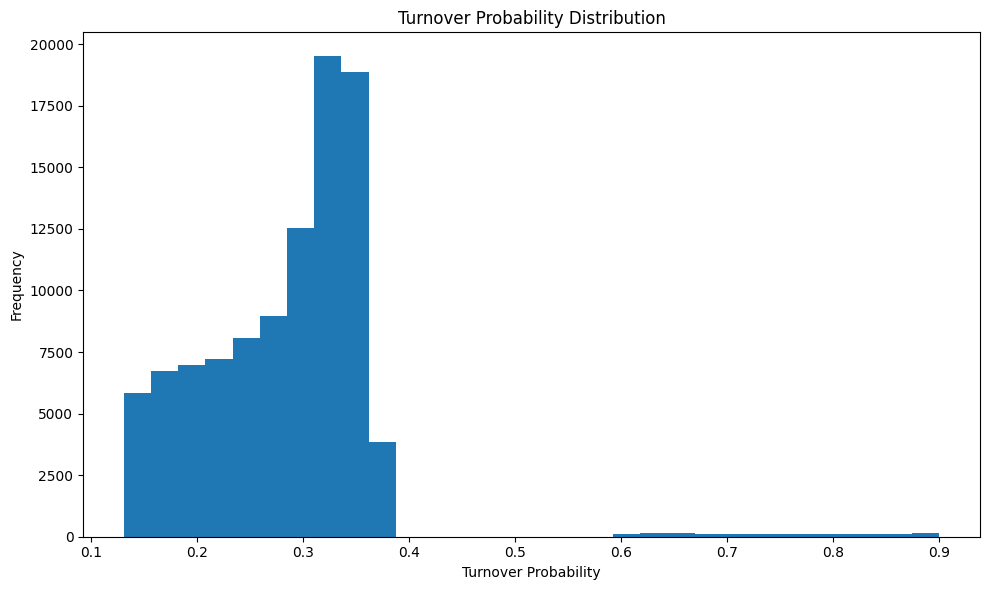

In [47]:
# Inspect histogram of 'turnover_probability_generated'
plt.figure(figsize=(10,6))
plt.hist(df['turnover_probability_generated'], bins=30)
plt.xlabel('Turnover Probability')
plt.ylabel('Frequency')
plt.title('Turnover Probability Distribution')
plt.tight_layout()
plt.show()

- 'turnover_probability_generated' came with the dataset and was not generated in this project.
- The histogram has an unusual distribution, with no representation between 0.4-0.6 and much lower levels between 0.6 and 0.9.

In [48]:
# Proportion of employees who left company
df['left_company'].value_counts()

left_company
False    71321
True     28679
Name: count, dtype: int64

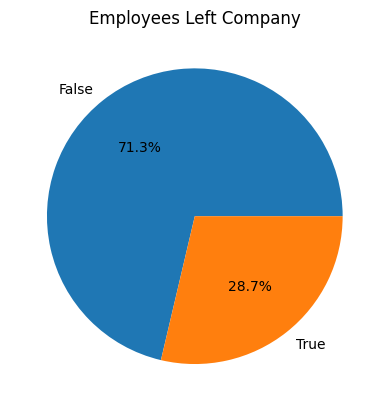

In [49]:
# Plot as a pie chart
ax = df['left_company'].value_counts().plot(kind = 'pie', autopct='%1.1f%%')

ax.set_ylabel('')  
plt.title('Employees Left Company')
plt.show()


- 71.3% of employees have not left the company they are in
- 28.7% of employees have left the company they were in

In [50]:
# Check persona_name values
df['persona_name'].value_counts()

persona_name
StrugglingLearner        10168
AmbitiousClimber          8326
9-to-5Clockwatcher        8282
ChangeResistor            8254
SteadyEddy                8198
OverachievingSprinter     8178
SocialCatalyst            8171
SeasonedExpert            8130
CorporateNavigator        8101
QuietAchiever             8067
NewEnthusiast             8065
BurntOutStar              8060
Name: count, dtype: int64

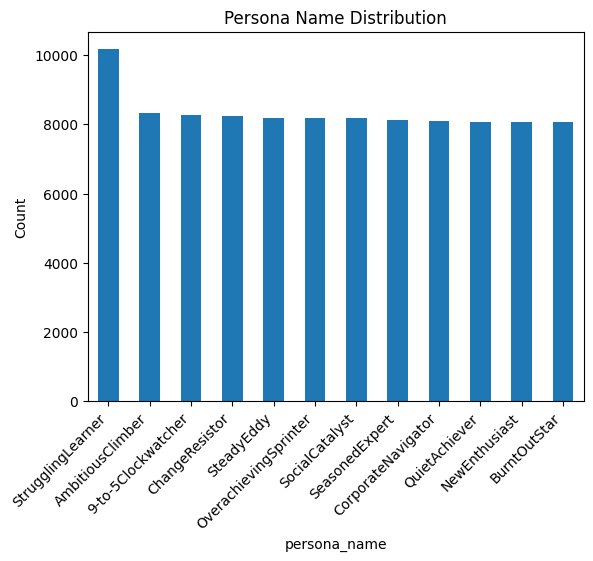

In [51]:
ax = df['persona_name'].value_counts().plot(
    kind='bar'
)

plt.title("Persona Name Distribution")
plt.ylabel("Count")
plt.xticks(rotation=45, ha='right')
plt.show()

- A relatively even split between all of the different persona names

In [52]:
df['communication_patterns'].value_counts()

communication_patterns
Exhibits communication style typical of a StrugglingLearner persona.        10168
Exhibits communication style typical of a AmbitiousClimber persona.          8326
Exhibits communication style typical of a 9-to-5Clockwatcher persona.        8282
Exhibits communication style typical of a ChangeResistor persona.            8254
Exhibits communication style typical of a SteadyEddy persona.                8198
Exhibits communication style typical of a OverachievingSprinter persona.     8178
Exhibits communication style typical of a SocialCatalyst persona.            8171
Exhibits communication style typical of a SeasonedExpert persona.            8130
Exhibits communication style typical of a CorporateNavigator persona.        8101
Exhibits communication style typical of a QuietAchiever persona.             8067
Exhibits communication style typical of a NewEnthusiast persona.             8065
Exhibits communication style typical of a BurntOutStar persona.            

"persona_name" maps directly to "communication_patterns". Dropping "communication_patterns" as it is redundent and adds no information.

In [53]:
# Drop "communication_patterns" see above
df = df.drop(columns=['communication_patterns'], errors='ignore')

- See ydata report in initial data overview for further univariate feature understanding. Further detail is not required at this point. 

In [54]:
# Save cleaned data to csv
df.to_csv("../data/data_cleaned.csv", index=False)